<a href="https://colab.research.google.com/github/Sreejan09/ML---4/blob/main/Assignment_4_task_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import requests
from bs4 import BeautifulSoup
import time

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
google_image = "https://www.google.com/search?site=&tbm=isch&source=hp&biw=1873&bih=990&"
user_agent = {
    "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/70.0.3538.77 Safari/537.36"
}

In [ ]:
sunFlowerCount=1
neemTreeCount=1

In [ ]:

def download_images(index,name):
    data = input('What are you looking for? ')
    n_images = int(input('How many images do you want? '))
    #class_id=input('Enter the class id: ')
    print('searching...')

    search_url = google_image + 'q=' + data

    response = requests.get(search_url, headers=user_agent)

    html = response.text
    html_=str(html)
    sarray=html_.split('img class=')[2]
    print(sarray)
    class_context=sarray[1:100]
    class_id=class_context.split('"')[0]
    print('class_id: ',class_id)
    soup = BeautifulSoup(html, 'html.parser')

    results = soup.findAll('img', {'class': str(class_id)})
    print('results: ', len(results))
    count = 1
    links = []
    for result in results:
        try:
            #print("result: ",result)
            link = result['src']
            #print("link: ",link)
            links.append(link)
            count += 1
            if(count > n_images):
                break

        except Exception as e:
            print(e.__class__)
            continue

    print(f"Downloading {len(links)} images...")
    for i, link in enumerate(links):
        response = requests.get(link)

        image_name = saved_folder + '/'+ name+'/'+ name+'_'+str(index) + '.jpg'
        index+=1

        with open(image_name, 'wb') as fh:
            fh.write(response.content)
        time.sleep(1)

In [ ]:

def main():
    if not os.path.exists(saved_folder):
        os.makedirs(saved_folder, exist_ok=True)  # Use os.makedirs with exist_ok=True for recursive directory creation
    if not os.path.exists(os.path.join(saved_folder, 'sunFlower')):
        os.mkdir(os.path.join(saved_folder, 'sunFlower')) #create sunflower directory if it does not exist
    if not os.path.exists(os.path.join(saved_folder, 'neemTree')):
        os.mkdir(os.path.join(saved_folder, 'neemTree'))#create neemTree directory if it does not exist


    for i in range(5):
        download_images(i*20+1,'sunFlower')
    for i in range(5):
        download_images(i*20+1,'neemTree')

main()

In [ ]:
import torch
import torchvision
import torch.optim as optim
from torchvision import transforms
from PIL import Image
from torch.utils.data import DataLoader, random_split,Dataset
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:

class ImageLabelDataset(Dataset):
  def __init__(self, data_dir, transform=None):
    self.data_dir = data_dir
    self.image_paths = [os.path.join(data_dir, f) for f in os.listdir(data_dir) if os.path.isfile(os.path.join(data_dir, f))]
    self.transform = transform

  def __len__(self):
    return len(self.image_paths)

  def __getitem__(self, idx):
    image_path = self.image_paths[idx]
    # Load image as RGB (mode='RGB')
    image = Image.open(image_path).convert('RGB')
    # Assuming your labels are encoded in the filenames (modify as needed)
    label = os.path.splitext(os.path.basename(image_path))[0].split("_")[0]
    # Convert label to integer if needed (modify as needed)
    #print("LABEL: ",label)
    if label == 'sunFlower':
        label = [0,1]
    else:
        label = [1,0]
    if self.transform:
      image = self.transform(image)
    return image, label


In [ ]:
data_dir = '/content/drive/MyDrive/Assignment_4_data/images/combine'
data_transforms = transforms.Compose([
  transforms.Resize((200,200)),  # Resize images to 256x256
  transforms.ToTensor(),
  transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
dataset = ImageLabelDataset(data_dir,data_transforms)


In [ ]:
print(dataset[0][0].shape)

torch.Size([3, 200, 200])


In [ ]:
import os
import shutil

# Define folder paths
sunflower_folder = '/content/drive/MyDrive/Assignment_4_data/images/sunFlower'
neemtree_folder = '/content/drive/MyDrive/Assignment_4_data/images/neemTree'
combine_folder = '/content/drive/MyDrive/Assignment_4_data/images/combine'

# Create the combine folder if it doesn't exist
os.makedirs(combine_folder, exist_ok=True)

def copy_folder_contents(source_folder, destination_folder):
    # Iterate through all files in the source folder
    for item in os.listdir(source_folder):
        source_path = os.path.join(source_folder, item)
        destination_path = os.path.join(destination_folder, item)

        # Check if it's a file or a folder
        if os.path.isfile(source_path):
            # Copy file to destination folder
            shutil.copy2(source_path, destination_path)
        elif os.path.isdir(source_path):
            # Recursively copy subfolders
            shutil.copytree(source_path, destination_path, dirs_exist_ok=True)

# Copy contents of both folders to the combine folder
copy_folder_contents(sunflower_folder, combine_folder)
copy_folder_contents(neemtree_folder, combine_folder)

print("Contents of 'sunFlower' and 'neemTree' have been combined into 'combine'.")


Contents of 'sunFlower' and 'neemTree' have been combined into 'combine'.


In [ ]:
test_size = 0.2
train_size = int(len(dataset) * (1 - test_size))
train_dataset, test_dataset = random_split(dataset, [train_size, len(dataset) - train_size])

# Create training and testing loaders
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=32, shuffle=False)


In [ ]:
import torch.nn as nn
class VGG(nn.Module):
    def __init__(
        self,
        architecture,
        in_channels=3,
        in_height=224,
        in_width=224,
        num_hidden=4096,
        num_classes=2
    ):
        super(VGG, self).__init__()
        self.in_channels = in_channels
        self.in_width = in_width
        self.in_height = in_height
        self.num_hidden = num_hidden
        self.num_classes = num_classes
        self.convs = self.init_convs(architecture)
        self.fcs = self.init_fcs(architecture)

    def forward(self, x):
        x = self.convs(x)
        x = x.reshape(x.size(0), -1)
        x = self.fcs(x)
        return x

    def init_fcs(self, architecture):
        pool_count = architecture.count("M")
        factor = (2 ** pool_count)
        if (self.in_height % factor) + (self.in_width % factor) != 0:
            raise ValueError(
                f"`in_height` and `in_width` must be multiples of {factor}"
            )
        out_height = self.in_height // factor
        out_width = self.in_width // factor
        last_out_channels = next(
            x for x in architecture[::-1] if type(x) == int
        )
        return nn.Sequential(
            nn.Linear(
                last_out_channels * out_height * out_width,
                self.num_hidden),
            nn.ReLU(),
            nn.Dropout(p=0.5),
            nn.Linear(self.num_hidden, self.num_hidden),
            nn.ReLU(),
            nn.Dropout(p=0.5),
            nn.Linear(self.num_hidden, self.num_classes)
        )


    def init_convs(self, architecture):
        layers = []
        in_channels = self.in_channels

        for x in architecture:
            if type(x) == int:
                out_channels = x
                layers.extend(
                    [
                        nn.Conv2d(
                            in_channels=in_channels,
                            out_channels=out_channels,
                            kernel_size=(3, 3),
                            stride=(1, 1),
                            padding=(1, 1),
                        ),
                        nn.BatchNorm2d(out_channels),
                        nn.ReLU(),
                    ]
                )
                in_channels = x
            else:
                layers.append(
                    nn.MaxPool2d(kernel_size=(2, 2), stride=(2, 2))
                )

        return nn.Sequential(*layers)


In [ ]:
VGG_types = {
    "VGG11": [64, "M", 128, "M", 256, 256, "M", 512, 512, "M", 512, 512, "M"],
    "VGG13": [64,64,"M",128,128,"M",256,256,"M",512,512,"M",512,512,"M",],
    "VGG16": [64,64,"M",128,128,"M",256,256,256,"M",512,512,512,"M",512,512,512,"M",],
    "VGG19": [64,64,"M",128,128,"M",256,256,256,256,"M",512,512,512,512,"M",512,512,512,512,"M",],
    "VGG1":[32,"M"],
    "VGG3": [32,"M",64,"M",128,"M"]
}
""
num_classes = 2
num_epochs = 20
total_step = len(train_loader)

In [ ]:
def find_train_accuracy(model,train_loader):
    correct = 0
    total = 0
    model.eval()
    with torch.no_grad():
        for images, labels in train_loader:
            images = images.to(device)
            labels=torch.stack((labels[0], labels[1]),dim=1)
            labels=labels.float()
            labels = labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            _, labels = torch.max(labels, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return (correct / total) * 100
dict={1:"sunFlower",0:"neemTree"}
inv_normalize = transforms.Normalize(
    mean=[-0.485/0.229, -0.456/0.224, -0.406/0.255],
    std=[1/0.229, 1/0.224, 1/0.255]
)
def find_test_accuracy(model,test_loader,summaryWriter=None,nr=5,nc=8):
    correct = 0
    total = 0
    model.eval()
    step=0

    if summaryWriter!=None:
      fig, ax = plt.subplots(nrows = nr, ncols = nc, figsize = (40,20))

    with torch.no_grad():
        for images, labels in test_loader:
            images = images.to(device)
            labels=torch.stack((labels[0], labels[1]),dim=1)
            labels=labels.float()
            labels = labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            _, labels = torch.max(labels, 1)
            total += labels.size(0)
            p=predicted.cpu().numpy()
            l=labels.cpu().numpy()
            # print(l)
            # print(p)
            # print("img : ",images[0])
            if summaryWriter !=None:
              for i in range(len(images)):
                  img=inv_normalize(images[i])
                  ax.ravel()[step].imshow(img.cpu().permute(1, 2, 0))
                  # print(ax.ravel())
                  ax.ravel()[step].set_title(f'Class : {dict[p[i]]}')
                  ax.ravel()[step].set_axis_off()
                  step+=1
              # combined_image = torch.cat((grid, predicted), dim=1)

              # summaryWriter.add_figure("Images with Labels",fig,1)
              # for i in range(len(p)):
                  # img=inv_normalize(images[i])
                  # summaryWriter.add_image(f"Predicted {dict[p[i]]} and Actual {dict[l[i]]}",img,global_step=0)

            correct += (predicted == labels).sum().item()
    return (correct / total) * 100

def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)


In [ ]:
import time
def train_moodel(model,train_loader,epochs,model_name,summaryWriter):
    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    model.to(device)
    start_time = time.time()
    step=0

    for epoch in range(epochs):
        running_loss = 0.0
        for i, (images, labels) in enumerate(train_loader):
            # Move tensors to the configured device
            images = images.to(device)
            labels=torch.stack((labels[0], labels[1]),dim=1)
            labels=labels.float()
            labels = labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            running_loss += loss.item() * labels.size(0)
            summaryWriter.add_scalar('training loss', loss.item(), global_step=step)
            summaryWriter.add_scalar('training accuracy', find_train_accuracy(model,train_loader), global_step=step)
            summaryWriter.add_scalar('testing accuracy', find_test_accuracy(model,test_loader), global_step=step)
            model.train()
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            step+=1
            del images,labels
        train_loss = running_loss / len(train_loader.dataset)
        print('Epoch [{}/{}], Loss: {:.4f}'.format(epoch+1, epochs, train_loss))
    end_time = time.time()
    summaryWriter.flush()
    summaryWriter.close()
    torch.save(model.state_dict(),f"/content/drive/MyDrive/Assignment_4_data/model/{model_name}.pt")
    print('Time: ',end_time - start_time)
    return (end_time - start_time),train_loss

In [ ]:
model_details={"Model_Name":[],"Traning_Time":[],"Training_Loss":[],"Train_Accuracy":[],"Test_Accuracy":[],"Number_Of_Parameters":[]}

# I) Training VGG 1 block model

Epoch [1/20], Loss: 37.0533
Epoch [2/20], Loss: 20.9418
Epoch [3/20], Loss: 5.4774
Epoch [4/20], Loss: 4.6639
Epoch [5/20], Loss: 4.3370
Epoch [6/20], Loss: 0.7871
Epoch [7/20], Loss: 2.9815
Epoch [8/20], Loss: 0.0649
Epoch [9/20], Loss: 0.7439
Epoch [10/20], Loss: 0.0811
Epoch [11/20], Loss: 0.2256
Epoch [12/20], Loss: 0.2235
Epoch [13/20], Loss: 0.0456
Epoch [14/20], Loss: 0.0000
Epoch [15/20], Loss: 0.0464
Epoch [16/20], Loss: 0.0694
Epoch [17/20], Loss: 0.0000
Epoch [18/20], Loss: 0.0177
Epoch [19/20], Loss: 0.0120
Epoch [20/20], Loss: 0.0000
Time:  330.02943110466003


Train Accuracy:  100.0
Test Accuracy:  97.5
Train Time:  330.02943110466003
Loss:  4.734040167203055e-05
total_params:  328733634


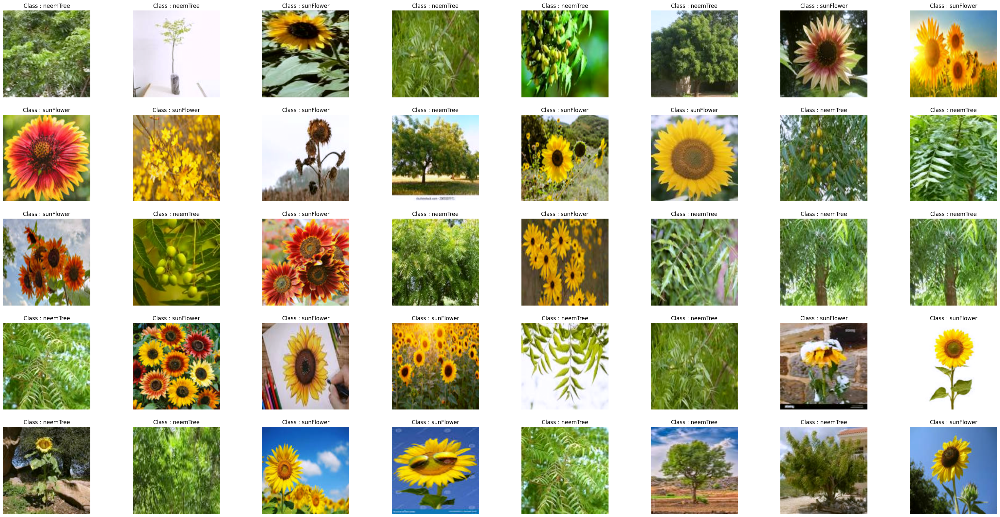

In [ ]:
model = VGG(VGG_types["VGG1"], in_channels=3, in_height=200, in_width=200, num_hidden=1024, num_classes=2)
summaryWriter=SummaryWriter(f"runs/vgg/vgg1")
train_time,loss=train_moodel(model,train_loader,20,"vgg1",summaryWriter)
train_accuracy=find_train_accuracy(model,train_loader)
test_accuracy=find_test_accuracy(model,test_loader,summaryWriter)
total_params=count_parameters(model)
summaryWriter.flush()
summaryWriter.close()
model_details["Model_Name"].append("VGG 1 Block")
model_details["Traning_Time"].append(train_time)
model_details["Train_Accuracy"].append(train_accuracy)
model_details["Test_Accuracy"].append(test_accuracy)
model_details["Number_Of_Parameters"].append(total_params)
model_details["Training_Loss"].append(loss)
print("Train Accuracy: ",train_accuracy)
print("Test Accuracy: ",test_accuracy)
print("Train Time: ",train_time)
print("Loss: ",loss)
print("total_params: ",total_params)

# II) Training VGG 3 block model

Epoch [1/20], Loss: 18.9147
Epoch [2/20], Loss: 3.7317
Epoch [3/20], Loss: 1.4303
Epoch [4/20], Loss: 0.6978
Epoch [5/20], Loss: 0.2356
Epoch [6/20], Loss: 0.1824
Epoch [7/20], Loss: 0.1078
Epoch [8/20], Loss: 0.1739
Epoch [9/20], Loss: 0.0773
Epoch [10/20], Loss: 0.0469
Epoch [11/20], Loss: 0.0227
Epoch [12/20], Loss: 0.0697
Epoch [13/20], Loss: 0.0267
Epoch [14/20], Loss: 0.0107
Epoch [15/20], Loss: 0.0717
Epoch [16/20], Loss: 0.0110
Epoch [17/20], Loss: 0.0144
Epoch [18/20], Loss: 0.0073
Epoch [19/20], Loss: 0.0126
Epoch [20/20], Loss: 0.0112
Time:  337.4131672382355


Train Accuracy:  100.0
Test Accuracy:  95.0
Train Time:  337.4131672382355
Loss:  0.011154907994932729
total_params:  83066370


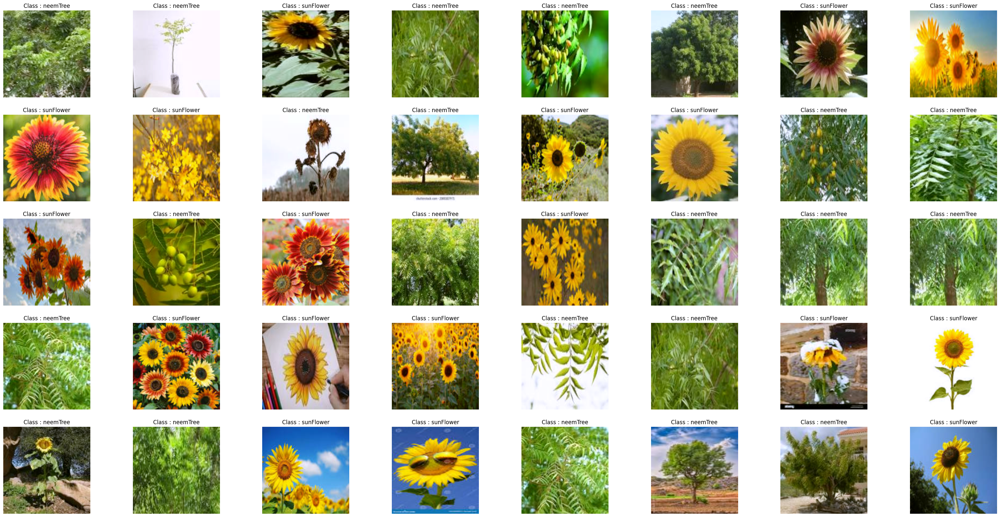

In [ ]:
model = VGG(VGG_types["VGG3"], in_channels=3, in_height=200, in_width=200, num_hidden=1024, num_classes=2)
summaryWriter=SummaryWriter(f"runs/vgg/vgg3")
train_time,loss=train_moodel(model,train_loader,20,"vgg3",summaryWriter)
train_accuracy=find_train_accuracy(model,train_loader)
test_accuracy=find_test_accuracy(model,test_loader,summaryWriter)
summaryWriter.flush()
summaryWriter.close()
total_params=count_parameters(model)
model_details["Model_Name"].append("VGG 3 Block")
model_details["Traning_Time"].append(train_time)
model_details["Train_Accuracy"].append(train_accuracy)
model_details["Test_Accuracy"].append(test_accuracy)
model_details["Number_Of_Parameters"].append(total_params)
model_details["Training_Loss"].append(loss)
print("Train Accuracy: ",train_accuracy)
print("Test Accuracy: ",test_accuracy)
print("Train Time: ",train_time)
print("Loss: ",loss)
print("total_params: ",total_params)

In [ ]:
data_transforms_ = transforms.Compose([

  transforms.ToTensor(),
  transforms.RandomHorizontalFlip(p=1),
  transforms.RandomVerticalFlip(p=1),
  transforms.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0.5),
  transforms.RandomRotation(degrees=(-90,90))
])

In [ ]:
src_dir="/content/drive/MyDrive/Assignment_4_data/images/combine/"
dest_dir="/content/drive/MyDrive/Assignment_4_data/images/augmented/"

In [ ]:
# from torchvision import datasets

# dataset = datasets.ImageFolder(root=src_dir)
# print(dataset)
if not os.path.exists(dest_dir):
        os.mkdir(dest_dir)
from os import listdir
from os.path import isfile, join
onlyfiles = [f for f in listdir(src_dir) if isfile(join(src_dir, f))]
for file in onlyfiles:
  image = Image.open(src_dir+file).convert('RGB')
  image_=data_transforms_(image)
  image_ = transforms.ToPILImage()(image_)
  label = os.path.splitext(file)[0].split("_")
  image_.save(dest_dir+f"{label[0]}_a_{label[1]}.jpg")
  image.save(dest_dir+f"{label[0]}_{label[1]}.jpg")

In [ ]:
data_transforms = transforms.Compose([
  transforms.Resize((200,200)),  # Resize images to 256x256
  transforms.ToTensor(),
  transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [ ]:
dataset_ = ImageLabelDataset(dest_dir,data_transforms)

test_size = 0.2
train_size = int(len(dataset_) * (1 - test_size))
train_dataset_, test_dataset_ = random_split(dataset_, [train_size, len(dataset_) - train_size])

# Create training and testing loaders
train_loader_ = torch.utils.data.DataLoader(train_dataset_, batch_size=32, shuffle=True)
test_loader_ = torch.utils.data.DataLoader(test_dataset_, batch_size=32, shuffle=False)

In [ ]:
print(len(dataset_))

400


 # III) Training VGG 3 block model with data augmentation

In [ ]:
len(test_loader_.dataset)

80

Epoch [1/20], Loss: 10.5360
Epoch [2/20], Loss: 2.0475
Epoch [3/20], Loss: 1.1145
Epoch [4/20], Loss: 0.8146
Epoch [5/20], Loss: 0.5633
Epoch [6/20], Loss: 0.4682
Epoch [7/20], Loss: 0.4541
Epoch [8/20], Loss: 0.5076
Epoch [9/20], Loss: 0.4201
Epoch [10/20], Loss: 0.3793
Epoch [11/20], Loss: 0.4063
Epoch [12/20], Loss: 0.3602
Epoch [13/20], Loss: 0.2861
Epoch [14/20], Loss: 0.3256
Epoch [15/20], Loss: 0.3186
Epoch [16/20], Loss: 0.3211
Epoch [17/20], Loss: 0.3101
Epoch [18/20], Loss: 0.3661
Epoch [19/20], Loss: 0.2699
Epoch [20/20], Loss: 0.2691
Time:  1068.8118541240692


Train Accuracy:  95.625
Test Accuracy:  75.0
Train Time:  1068.8118541240692
Loss:  0.26911987364292145
total_params:  83066370


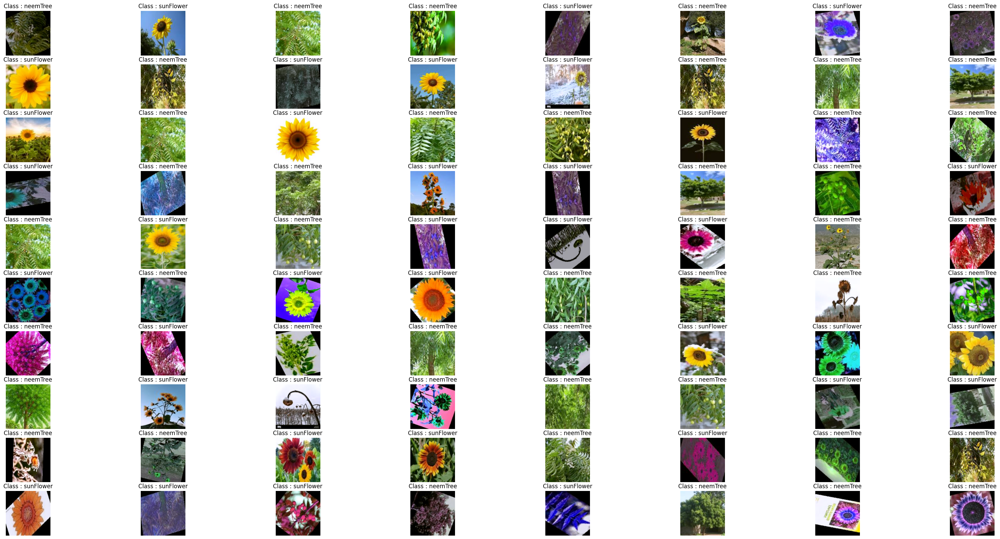

In [ ]:
model = VGG(VGG_types["VGG3"], in_channels=3, in_height=200, in_width=200, num_hidden=1024, num_classes=2)
summaryWriter=SummaryWriter(f"runs/vgg/vgg3_augmented")
train_time,loss=train_moodel(model,train_loader_,20,"vgg3_augmented",summaryWriter)
train_accuracy=find_train_accuracy(model,train_loader_)
test_accuracy=find_test_accuracy(model,test_loader_,summaryWriter,10,8)
summaryWriter.flush()
summaryWriter.close()
total_params=count_parameters(model)
model_details["Model_Name"].append("VGG 3 Block Augmented")
model_details["Traning_Time"].append(train_time)
model_details["Train_Accuracy"].append(train_accuracy)
model_details["Test_Accuracy"].append(test_accuracy)
model_details["Number_Of_Parameters"].append(total_params)
model_details["Training_Loss"].append(loss)
print("Train Accuracy: ",train_accuracy)
print("Test Accuracy: ",test_accuracy)
print("Train Time: ",train_time)
print("Loss: ",loss)
print("total_params: ",total_params)

# IV) Training VGG 16 block model with transfer learning by tuning all layers(including convolution layers)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 234MB/s]


Epoch [1/20], Loss: 8.3750
Epoch [2/20], Loss: 0.6829
Epoch [3/20], Loss: 1.1140
Epoch [4/20], Loss: 0.8071
Epoch [5/20], Loss: 0.7032
Epoch [6/20], Loss: 0.6176
Epoch [7/20], Loss: 0.8755
Epoch [8/20], Loss: 0.7108
Epoch [9/20], Loss: 0.6853
Epoch [10/20], Loss: 0.6715
Epoch [11/20], Loss: 0.6512
Epoch [12/20], Loss: 0.6483
Epoch [13/20], Loss: 0.6380
Epoch [14/20], Loss: 0.6265
Epoch [15/20], Loss: 0.6666
Epoch [16/20], Loss: 0.6146
Epoch [17/20], Loss: 0.5754
Epoch [18/20], Loss: 0.7834
Epoch [19/20], Loss: 0.6755
Epoch [20/20], Loss: 0.5827
Time:  934.9068095684052


Train Accuracy:  73.125
Test Accuracy:  65.0
Train Time:  934.9068095684052
Loss:  0.5827289462089539
total_params:  41457474


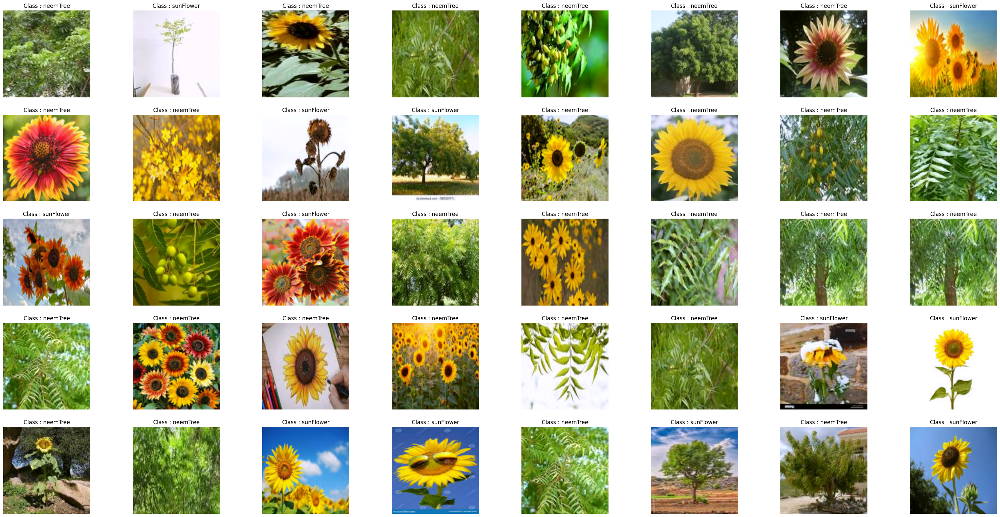

In [ ]:
import torchvision.models as models
model = models.vgg16(weights='DEFAULT')
in_height = 224
in_width = 224

pool_count = VGG_types["VGG16"].count("M")
factor = (2 ** pool_count)
if (in_height % factor) + (in_width % factor) != 0:
    raise ValueError(
                f"`in_height` and `in_width` must be multiples of {factor}"
    )
out_height = in_height // factor
out_width = in_width // factor
last_out_channels = next(
            x for x in VGG_types["VGG16"][::-1] if type(x) == int
    )
model.classifier=nn.Sequential(nn.Linear(last_out_channels*out_height*out_width,1024),nn.ReLU(),nn.Dropout(p=0.5), nn.Linear(1024,1024),nn.ReLU(),nn.Dropout(p=0.5), nn.Linear(1024,2))
summaryWriter=SummaryWriter(f"runs/vgg/vgg16_Transfer_Learning_1")
train_time,loss=train_moodel(model,train_loader,20,"vgg16_Transfer_Learning_1",summaryWriter)
train_accuracy=find_train_accuracy(model,train_loader)
test_accuracy=find_test_accuracy(model,test_loader,summaryWriter)
total_params=count_parameters(model)
summaryWriter.flush()
summaryWriter.close()
model_details["Model_Name"].append("VGG 16 Transfer Learning 1")
model_details["Traning_Time"].append(train_time)
model_details["Train_Accuracy"].append(train_accuracy)
model_details["Test_Accuracy"].append(test_accuracy)
model_details["Number_Of_Parameters"].append(total_params)
model_details["Training_Loss"].append(loss)
print("Train Accuracy: ",train_accuracy)
print("Test Accuracy: ",test_accuracy)
print("Train Time: ",train_time)
print("Loss: ",loss)
print("total_params: ",total_params)

# V) Training VGG 16 block model with transfer learning by tuning only MLP layers

Epoch [1/20], Loss: 0.3730
Epoch [2/20], Loss: 0.0084
Epoch [3/20], Loss: 0.0000
Epoch [4/20], Loss: 0.0004
Epoch [5/20], Loss: 0.0000
Epoch [6/20], Loss: 0.0000
Epoch [7/20], Loss: 0.0000
Epoch [8/20], Loss: 0.0000
Epoch [9/20], Loss: 0.0000
Epoch [10/20], Loss: 0.0000
Epoch [11/20], Loss: 0.0000
Epoch [12/20], Loss: 0.0000
Epoch [13/20], Loss: 0.0000
Epoch [14/20], Loss: 0.0000
Epoch [15/20], Loss: 0.0000
Epoch [16/20], Loss: 0.0000
Epoch [17/20], Loss: 0.0000
Epoch [18/20], Loss: 0.0000
Epoch [19/20], Loss: 0.0000
Epoch [20/20], Loss: 0.0000
Time:  783.5253756046295


AttributeError: 'list' object has no attribute 'appe3nd'

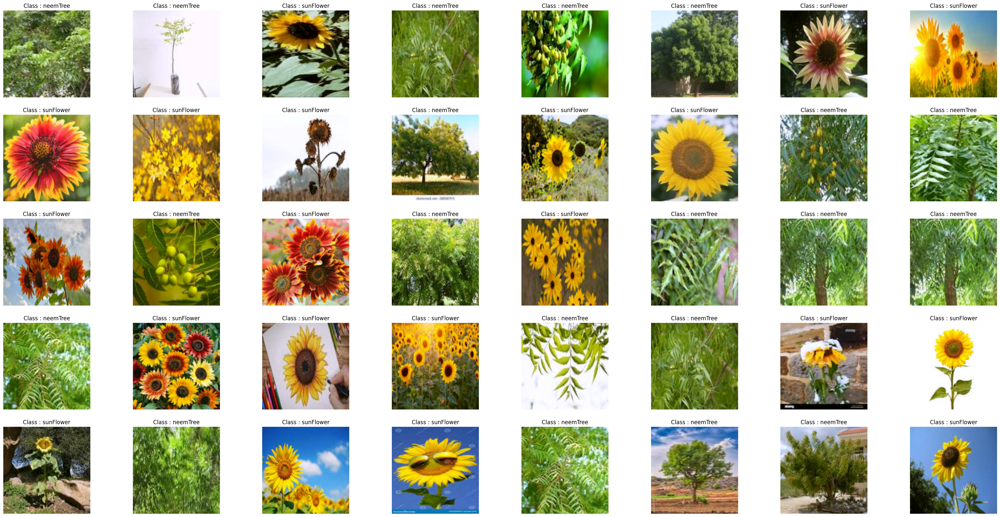

In [ ]:
import torchvision.models as models
model = models.vgg16(weights='DEFAULT')
in_height = 224
in_width = 224

pool_count = VGG_types["VGG16"].count("M")
factor = (2 ** pool_count)
if (in_height % factor) + (in_width % factor) != 0:
    raise ValueError(
                f"`in_height` and `in_width` must be multiples of {factor}"
    )
out_height = in_height // factor
out_width = in_width // factor
last_out_channels = next(
            x for x in VGG_types["VGG16"][::-1] if type(x) == int
    )
for param in model.features.parameters():
    param.requires_grad = False
model.classifier=nn.Sequential(nn.Linear(last_out_channels*out_height*out_width,1024),nn.ReLU(),nn.Dropout(p=0.5), nn.Linear(1024,1024),nn.ReLU(),nn.Dropout(p=0.5), nn.Linear(1024,2))
summaryWriter=SummaryWriter(f"runs/vgg/vgg16_Transfer_Learning_2")
train_time,loss=train_moodel(model,train_loader,20,"vgg16_Transfer_Learning_2",summaryWriter)
train_accuracy=find_train_accuracy(model,train_loader)
test_accuracy=find_test_accuracy(model,test_loader,summaryWriter)
summaryWriter.flush()
summaryWriter.close()
total_params=count_parameters(model)
model_details["Model_Name"].append("VGG 16 Transfer Learning 2")
model_details["Traning_Time"].append(train_time)
model_details["Train_Accuracy"].append(train_accuracy)
model_details["Test_Accuracy"].append(test_accuracy)
model_details["Number_Of_Parameters"].append(total_params)
model_details["Training_Loss"].append(loss)
print("Train Accuracy: ",train_accuracy)
print("Test Accuracy: ",test_accuracy)
print("Train Time: ",train_time)
print("Loss: ",loss)
print("total_params: ",total_params)

In [ ]:
model_details["Model_Name"].append("VGG 16 Transfer Learning 2")
model_details["Traning_Time"].append(train_time)
model_details["Train_Accuracy"].append(train_accuracy)
model_details["Test_Accuracy"].append(test_accuracy)
model_details["Number_Of_Parameters"].append(total_params)
model_details["Training_Loss"].append(loss)
print("Train Accuracy: ",train_accuracy)
print("Test Accuracy: ",test_accuracy)
print("Train Time: ",train_time)
print("Loss: ",loss)
print("total_params: ",total_params)

Train Accuracy:  100.0
Test Accuracy:  100.0
Train Time:  783.5253756046295
Loss:  4.395928860604238e-09
total_params:  26742786


In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 20730), started 0:04:19 ago. (Use '!kill 20730' to kill it.)

<IPython.core.display.Javascript object>


# MLP Model which has comparable parameters to VGG 16

---


In [ ]:
import time
def train_mlp_moodel(model,train_loader,epochs,model_name):
    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    model.to(device)
    start_time = time.time()
    step=0

    for epoch in range(epochs):
        running_loss = 0.0
        for i, (images, labels) in enumerate(train_loader):
            # Move tensors to the configured device
            images = images.to(device)
            labels=torch.stack((labels[0], labels[1]),dim=1)
            labels=labels.float()
            labels = labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            running_loss += loss.item() * labels.size(0)
            model.train()
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            step+=1
            del images,labels
        train_loss = running_loss / len(train_loader.dataset)
        print('Epoch [{}/{}], Loss: {:.4f}'.format(epoch+1, epochs, train_loss))
    end_time = time.time()
    summaryWriter.flush()
    summaryWriter.close()
    torch.save(model.state_dict(),f"/content/drive/My Drive/Assignment_4_data/{model_name}.pt")
    print('Time: ',end_time - start_time)
    return (end_time - start_time),train_loss

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class MLP(nn.Module):
    def __init__(self, input_size, num_classes):
        super(MLP, self).__init__()
        self.fc1 = nn.Linear(input_size, 256)
        self.fc2 = nn.Linear(256,4096)
        self.fc3 = nn.Linear(4096,2048)
        self.fc4 = nn.Linear(2048,1024)
        self.fc5 = nn.Linear(1024, num_classes)
        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        x = x.view(x.size(0), -1)  # Flatten the input
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))
        x = self.dropout(x)
        x = F.relu(self.fc3(x))
        x = self.dropout(x)
        x = F.relu(self.fc4(x))
        x = self.dropout(x)
        x = self.fc5(x)
        return F.log_softmax(x, dim=1)

# Define the input size and number of classes
input_size = 200 * 200 * 3
num_classes = 2

# Instantiate the MLP model
mlp_model = MLP(input_size, num_classes)

# Count the total number of parameters
total_params = sum(p.numel() for p in mlp_model.parameters())
print("Total number of parameters:", total_params)


Total number of parameters: 42263810


In [ ]:
# Instantiate the MLP model
mlp_model = MLP(input_size=200*200*3, num_classes=2)
# Train the MLP model
train_time, loss = train_mlp_moodel(mlp_model, train_loader, 50,"MLP")
# Calculate training accuracy
train_accuracy = find_train_accuracy(mlp_model, train_loader)
# Calculate test accuracy
test_accuracy = find_test_accuracy(mlp_model, test_loader)
# Count total parameters
total_params = count_parameters(mlp_model)

Epoch [1/50], Loss: 13.4095
Epoch [2/50], Loss: 1.6428
Epoch [3/50], Loss: 1.2688
Epoch [4/50], Loss: 0.9994
Epoch [5/50], Loss: 0.9241
Epoch [6/50], Loss: 0.7351
Epoch [7/50], Loss: 0.7585
Epoch [8/50], Loss: 0.5243
Epoch [9/50], Loss: 0.4770
Epoch [10/50], Loss: 0.5440
Epoch [11/50], Loss: 0.8582
Epoch [12/50], Loss: 0.4069
Epoch [13/50], Loss: 0.5030
Epoch [14/50], Loss: 0.3577
Epoch [15/50], Loss: 0.4264
Epoch [16/50], Loss: 0.5031
Epoch [17/50], Loss: 0.5267
Epoch [18/50], Loss: 0.5352
Epoch [19/50], Loss: 0.5198
Epoch [20/50], Loss: 0.4149
Epoch [21/50], Loss: 0.4774
Epoch [22/50], Loss: 0.7012
Epoch [23/50], Loss: 0.3614
Epoch [24/50], Loss: 0.3802
Epoch [25/50], Loss: 0.3693
Epoch [26/50], Loss: 0.5060
Epoch [27/50], Loss: 0.5231
Epoch [28/50], Loss: 0.3998
Epoch [29/50], Loss: 0.4499
Epoch [30/50], Loss: 0.4337
Epoch [31/50], Loss: 0.3879
Epoch [32/50], Loss: 0.3753
Epoch [33/50], Loss: 0.3547
Epoch [34/50], Loss: 0.3657
Epoch [35/50], Loss: 0.3775
Epoch [36/50], Loss: 0.3579


In [ ]:
total_params=count_parameters(mlp_model)
print("Training time: ",train_time)
print("Train_Accuracy: ",train_accuracy)
print("Test_Accuracy: ",test_accuracy)
print("Number_Of_Parameters: ",total_params)
print("Train loss: ",loss)


Training time:  65.96108913421631
Train_Accuracy:  100.0
Test_Accuracy:  97.5
Number_Of_Parameters:  42263810
Train loss:  0.34966673851013186


The MLP model has 4 layers of size 256,4096,2048,1024 respectively. The model has 42263810 which is approximately same as VGG 16 model. The test accuracy is 97.5%

1) Images have a natural 2D (or 3D for volumetric data) structure where neighboring pixels are highly correlated. MLPs treat all inputs independently, ignoring this spatial information. CNNs leverage convolutional layers with filters that slide across the image, capturing local features and their spatial relationships. This allows them to learn features like edges, textures, and object parts that are crucial for image recognition.

2) CNNs employ stacked convolutional layers that build upon each other. The initial layers learn low-level features like edges and corners, while later layers combine these features into more complex ones, ultimately leading to object recognition.
MLPs don't have this built-in hierarchical feature learning capability.

In [ ]:
import shutil

In [ ]:
shutil.copytree('/content/runs', '/content/drive/MyDrive/Assignment_4_data/run')

'/content/drive/MyDrive/Assignment_4_data/run'

# 1) Are the results as expected? Why or why not?
 - VGG 1 block has 1 block of convolutional layers and 2 fully connected layers. The training time is low compare to other VGG models because of the less convolutional layers. This is expected because in CNN models there will be more time in training of convulutional layer compare to MLP layers

 - VGG 3 block has 3 block of convolutional layers and 2 fully connected layers. The training time is low compare to other VGG models 16 and high compare to vgg1.  This is expected because in CNN models there will be more time in training of convulutional layer compare

 VGG(3 block Augmented)
 - The traning time is high because here we took 400 images( 200 original + 200 augmented) and we train for 20 epochs.

 VGG 16 Transfer Learning 1 (With all parameters trainable)
  - The training time is high compare to other models because here we are training the model from scratch and we have 16 convolutional layers and 3 fully connected layers.


  



# 2) Does data augmentation help? Why or why not?


  -> Yes, data augmentation helps. Data augmentation is a technique to increase the size of the training data by applying various transformations like  rotation, flipping, scaling, etc. This helps the model to learn more features and generalize better on the unseen data. Also data augmentation depends on the type of data and the type of augmentation. In this case, we have only 200 images of each class which is very less and the model will overfit the training data. By applying data augmentation we are increasing the size of the training data and the model will learn more features and generalize better on the unseen data. In this case, the test accuracy of the model with augmented data is less compare to the model without augmented data. This is because the model is overfitting the training data and the augmented data is not helping the model to generalize better on the unseen data.



# 3)  Does it matter how many epochs you fine tune the model? Why or why not?

 Yes,In general training the number of epochs matters. The number of epochs is the number of times the model sees the entire training data. If we train the model for fewer epochs the model will not learn the features properly and the model will underfit the data. If we train the model for more epochs the model will learn the training data very well and the model will overfit the data. The model will perform well on the training data but will not perform well on the unseen data.

-> fine-tuning is about adjusting weights, so the same data is just recursively updated, which will mean the size of a fine-tune to remain the same regardless of the number of epochs it’s trained for. So it does not matters a much because the model is already pre trained on large dataset. So the model has already learned the features of the images. So we don't need to train the model for more epochs. The model will learn the features of the new dataset in few epochs.



  # 4) Are there any particular images that the model is confused about? Why or why not?
Yes, the model is confused about the images which are not clear and the images which are not in the center. Also some of the images contains other things with main objects and the training data is too small to cover all type of positions of main object with respect to other surrounding objects. Hence the model was not extracted those features very well and confused about those images.
